In [7]:
using Plots
using CSV
using DataFrames
using Glob

In [21]:
fnames = glob("data/mass*.dat")
dfs = []
for f in fnames
    push!(dfs, DataFrame(CSV.File(f)))
end

In [22]:
function get_col(name)
    a = [df[!, name] for df in dfs]
    return reduce(vcat, transpose.(a))
        
end

get_col (generic function with 1 method)

In [23]:
x1s = get_col("x1")
x2s = get_col("x2")
x3s = get_col("x3")

ρs = get_col("ρ")
Ts = get_col("T");

In [ ]:
@gif for i ∈ 1:1000
    x1 = x1s[:,i]
    x2 = x2s[:,i]

    
    c= Ts[:, i]
    scatter(x1, x2, marker_z=c, clim=(0,2000), xlim=[-100, 100], ylim=[-100, 100])
end

[ Info: Saved animation to /home/daniel/.julia/dev/GalaxySim/tmp.gif


Plots.AnimatedGif("/home/daniel/.julia/dev/GalaxySim/tmp.gif")
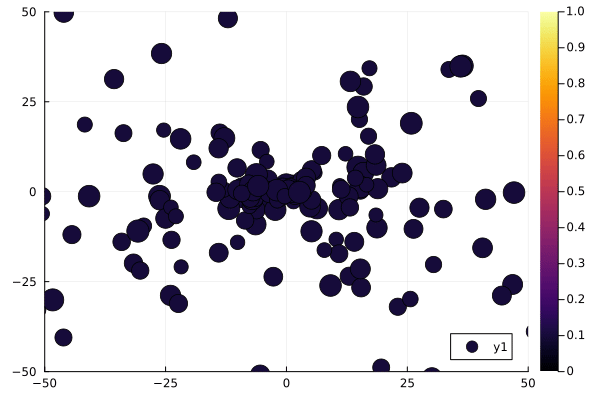

In [34]:
@gif for i ∈ 1:1000
    
    x_max = 50
    r_max = 20
    
    x3 = x3s[:,i]
    x1 = x1s[:,i]
    x2 = x2s[:,i]
    c= abs.(ρs[:, i])
    
    filt = abs.(x3) .< r_max
    s = (x_max .- abs.(x3))/r_max * 5
    
    scatter(x1[filt], x2[filt], marker_z=c[filt], ms=s[filt], clim=(0, 1), xlim=[-x_max, x_max], ylim=[-x_max, x_max])
end